# Advanced Lane Finding

## Import Libraries

In [1]:
import cv2
import glob
from IPython.display import HTML

import matplotlib
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline

from moviepy.editor import VideoFileClip
import numpy as np
import os
import pickle
from PIL import ImageFont, ImageDraw, Image

## Utility Functions

In [2]:
def figure(figsize, gssize):
    """
    Creates figure using the provided figure size and gridspec size. 
    """
    fig = plt.figure(figsize=figsize)
    fig.subplots_adjust(hspace=0.2, wspace=0.1)
    gs = gridspec.GridSpec(*gssize)
    return fig, gs

def imshow(image, gs, title=None, cmap=None, show_axis=False):
    """
    Shows the provided image onto the gridspec.
    """
    plt.subplot(gs)
    plt.imshow(image, cmap=cmap)
    if title is not None: plt.title(title)
    if not show_axis:
        plt.xticks([])
        plt.yticks([])
        plt.axis('off')

## Camera Calibration

### Find the Chessboard Corners

Successfully found chessboard corners in 17/20 images.


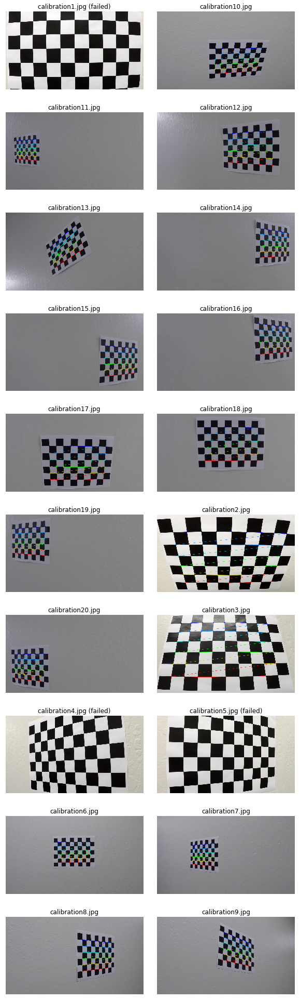

In [3]:
CHESSBOARD_IMAGE_PATH_PATTERN = './camera_cal/*.jpg'
NUM_CORNERS = (9, 6)

fig, gs = figure(figsize=(10, 35), gssize=(10, 2))

criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

objp = np.zeros((NUM_CORNERS[0] * NUM_CORNERS[1], 3), np.float32)
objp[:, :2] = np.mgrid[0:NUM_CORNERS[0], 0:NUM_CORNERS[1]].T.reshape(-1, 2)

objpoints = []
imgpoints = []

image_paths = glob.glob(CHESSBOARD_IMAGE_PATH_PATTERN)
image_paths = np.sort(image_paths)
success = 0
for i, path in enumerate(image_paths):
    image = mpimg.imread(path)
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, NUM_CORNERS, None)
    file_name = path.strip().split('/')[-1]
    if ret:
        corners2 = cv2.cornerSubPix(gray, corners, (11, 11), (-1, -1), criteria)
        
        objpoints.append(objp)
        imgpoints.append(corners2)
        imshow(cv2.drawChessboardCorners(image, NUM_CORNERS, corners2, ret), gs[i], file_name)
        
        success += 1
    else:
        imshow(image, gs[i], '{} (failed)'.format(file_name))

print('Successfully found chessboard corners in {}/{} images.'.format(success, len(image_paths)))

### Calibrate the Camera

In [4]:
IMG_SIZE = (720, 1280, 3)

ret, MTX, DIST, _, _ = cv2.calibrateCamera(objpoints, imgpoints, IMG_SIZE[-2::-1], None, None)
assert ret, 'Calibrate camera failed.'

### Function to Undistort Images

In [5]:
def undistort(image):
    """
    Undistorts the given image using the computed MTX and DIST.
    """
    return cv2.undistort(image, MTX, DIST, None, MTX)

### Undistort the Chessboard Images

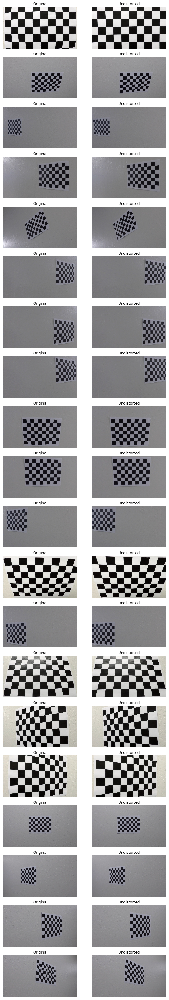

In [6]:
fig, gs = figure(figsize=(10, 60), gssize=(20, 2))

chessboard_image_paths = glob.glob(CHESSBOARD_IMAGE_PATH_PATTERN)
chessboard_image_paths = np.sort(chessboard_image_paths)
for i, path in enumerate(chessboard_image_paths):
    image = mpimg.imread(path)
    undist = undistort(image)
    
    imshow(image, gs[2*i], 'Original')
    imshow(undist, gs[2*i+1], 'Undistorted')

### Undistort the Test Images

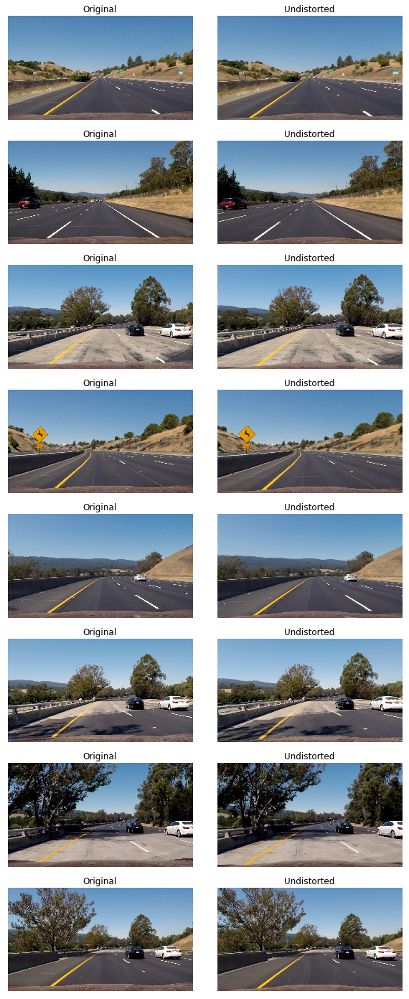

In [7]:
fig, gs = figure(figsize=(10, 25), gssize=(8, 2))

original_images = []
undist_images = []

test_image_paths = glob.glob('./test_images/*.jpg')
test_image_paths = np.sort(test_image_paths)
out_image_paths = './output_images'
for i, path in enumerate(test_image_paths):
    image = mpimg.imread(path)
    original_images.append(image)
    undist = undistort(image)
    undist_images.append(undist)
    
    file_name = path.split('/')[-1]
    mpimg.imsave('{}/undist-{}'.format(out_image_paths, file_name), undist)
    
    imshow(image, gs[2*i], 'Original')
    imshow(undist, gs[2*i+1], 'Undistorted')

## Lane Finding

### Plot RGB Channels

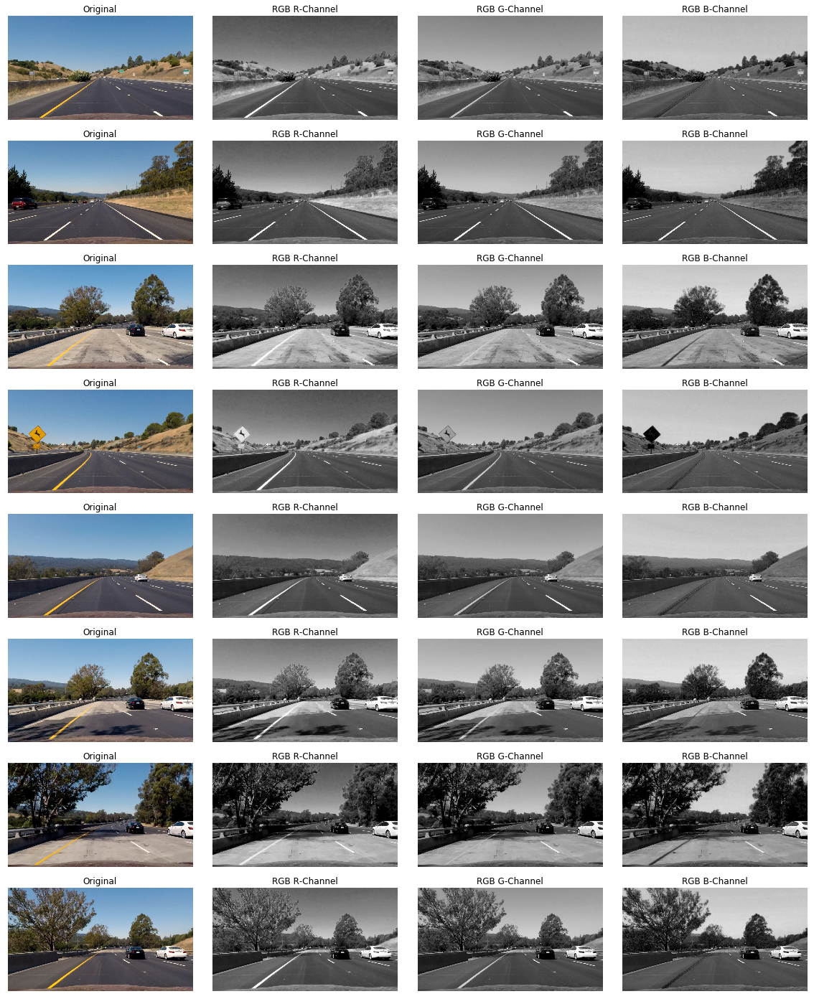

In [8]:
fig, gs = figure(figsize=(20, 25), gssize=(8, 4))
for i, image in enumerate(undist_images):
    image_R = image[:, :, 0]
    image_G = image[:, :, 1]
    image_B = image[:, :, 2]
    
    imshow(image, gs[4*i], 'Original')
    imshow(image_R, gs[4*i+1], 'RGB R-Channel', 'gray')
    imshow(image_G, gs[4*i+2], 'RGB G-Channel', 'gray')
    imshow(image_B, gs[4*i+3], 'RGB B-Channel', 'gray')

### Plot HSV Channels

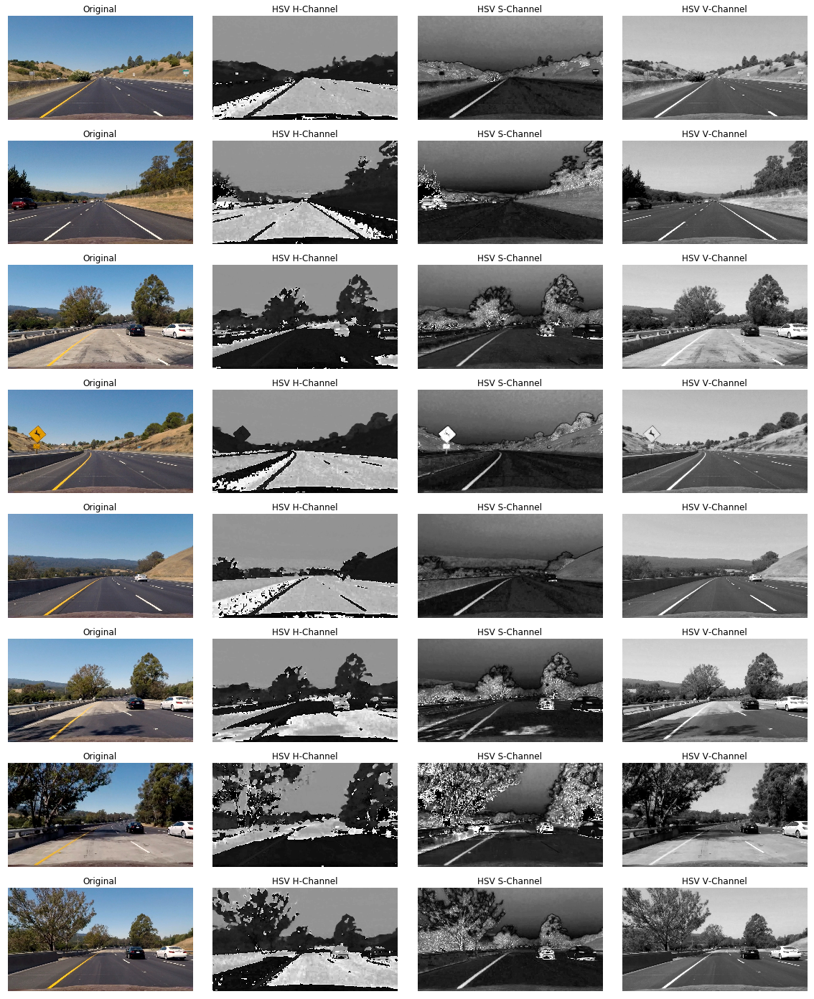

In [9]:
fig, gs = figure(figsize=(20, 25), gssize=(8, 4))
for i, image in enumerate(undist_images):
    hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    image_H = hsv[:, :, 0]
    image_S = hsv[:, :, 1]
    image_V = hsv[:, :, 2]
    
    imshow(image, gs[4*i], 'Original')
    imshow(image_H, gs[4*i+1], 'HSV H-Channel', 'gray')
    imshow(image_S, gs[4*i+2], 'HSV S-Channel', 'gray')
    imshow(image_V, gs[4*i+3], 'HSV V-Channel', 'gray')

### Plot HLS Channels

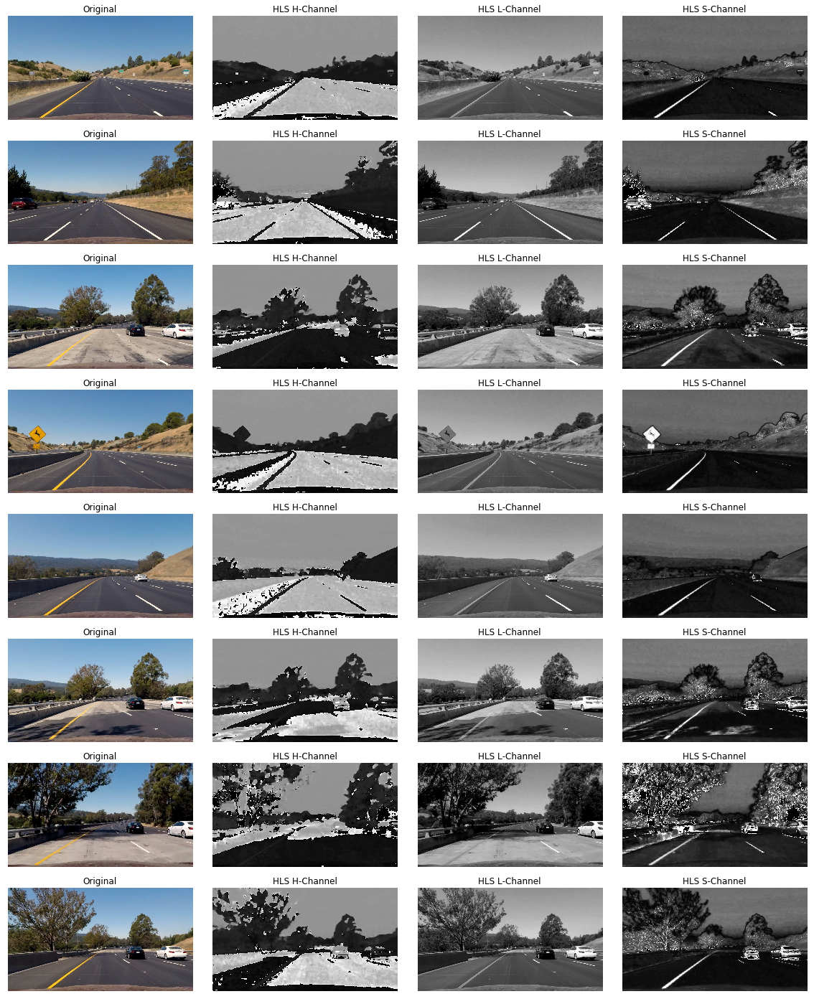

In [10]:
fig, gs = figure(figsize=(20, 25), gssize=(8, 4))
for i, image in enumerate(undist_images):
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    image_H = hls[:, :, 0]
    image_L = hls[:, :, 1]
    image_S = hls[:, :, 2]
    
    imshow(image, gs[4*i], 'Original')
    imshow(image_H, gs[4*i+1], 'HLS H-Channel', 'gray')
    imshow(image_L, gs[4*i+2], 'HLS L-Channel', 'gray')
    imshow(image_S, gs[4*i+3], 'HLS S-Channel', 'gray')

### Plot Lab Channels

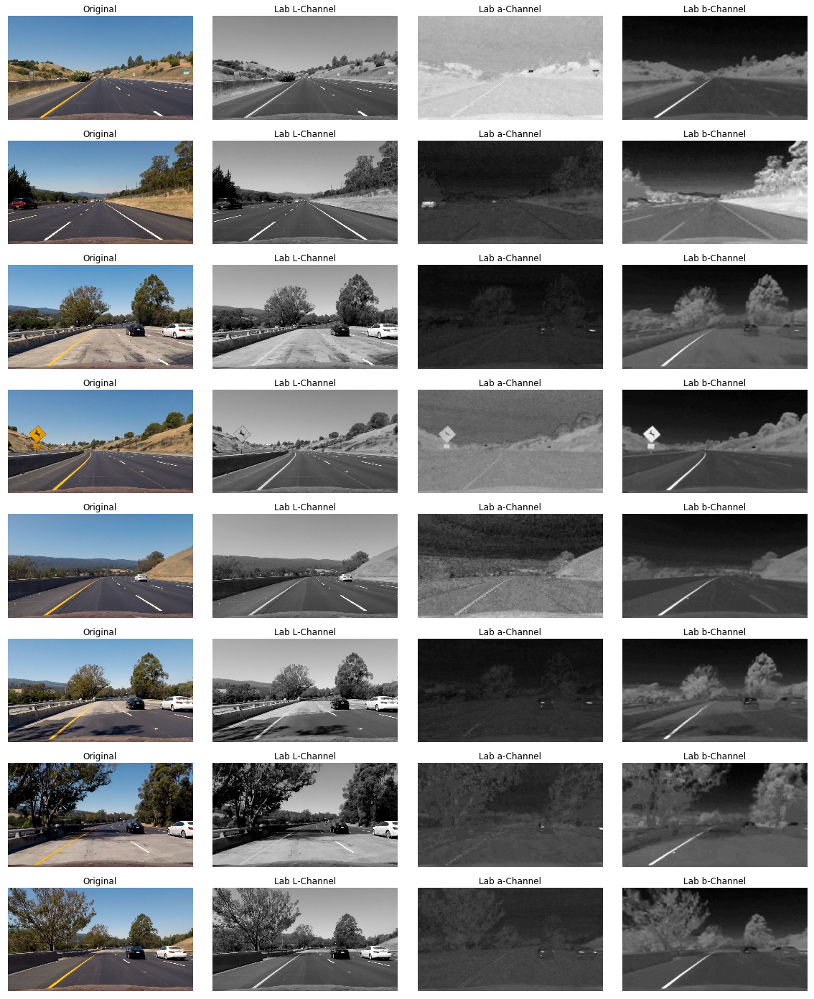

In [11]:
fig, gs = figure(figsize=(20, 25), gssize=(8, 4))
for i, image in enumerate(undist_images):
    lab = cv2.cvtColor(image, cv2.COLOR_RGB2Lab)
    image_L = lab[:, :, 0]
    image_A = lab[:, :, 1]
    image_B = lab[:, :, 2]
    
    imshow(image, gs[4*i], 'Original')
    imshow(image_L, gs[4*i+1], 'Lab L-Channel', 'gray')
    imshow(image_A, gs[4*i+2], 'Lab a-Channel', 'gray')
    imshow(image_B, gs[4*i+3], 'Lab b-Channel', 'gray')

### Plot Thresholded H-Channels in HLS Color Space

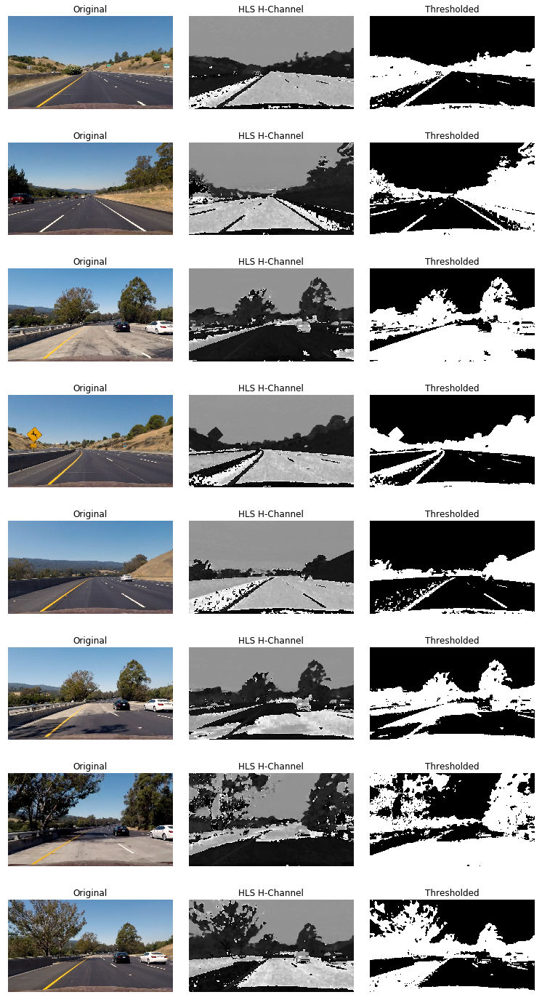

In [12]:
H_CHANNEL_THRESHOLD = (0, 80)

fig, gs = figure(figsize=(13, 25), gssize=(8, 3))
for i, image in enumerate(undist_images):
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)[:, :, 0]
    binary = np.zeros_like(gray)
    binary[(gray >= H_CHANNEL_THRESHOLD[0]) & (gray <= H_CHANNEL_THRESHOLD[1])] = 1
    
    imshow(image, gs[3*i], title='Original')
    imshow(gray, gs[3*i+1], title='HLS H-Channel', cmap='gray')
    imshow(binary, gs[3*i+2], title='Thresholded', cmap='gray')

### Plot Thresholded S-Channels in HLS Color Space

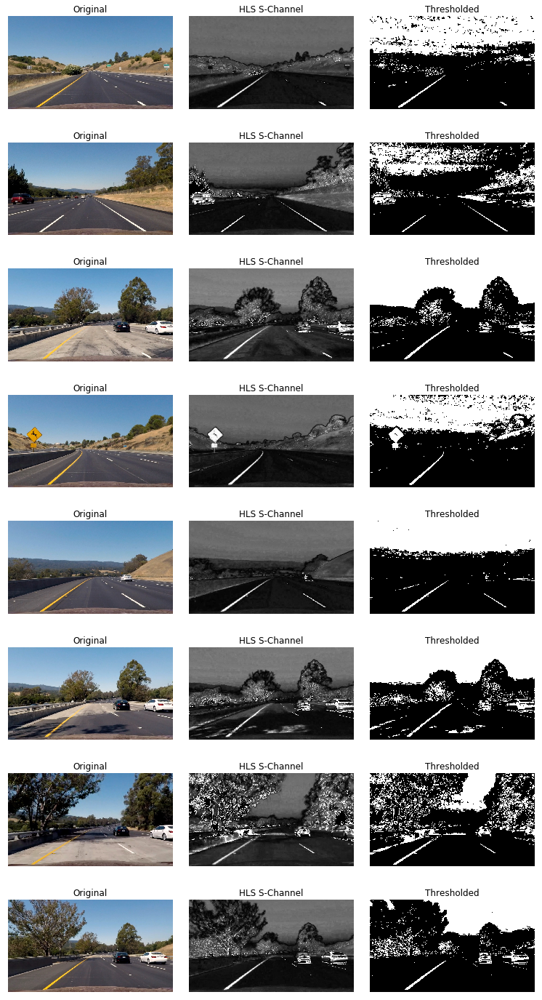

In [13]:
S_CHANNEL_THRESHOLD = (100, 255)

fig, gs = figure(figsize=(13, 25), gssize=(8, 3))
for i, image in enumerate(undist_images):
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)[:, :, 2]
    binary = np.zeros_like(gray)
    binary[(gray >= S_CHANNEL_THRESHOLD[0]) & (gray <= S_CHANNEL_THRESHOLD[1])] = 1
    
    imshow(image, gs[3*i], title='Original')
    imshow(gray, gs[3*i+1], title='HLS S-Channel', cmap='gray')
    imshow(binary, gs[3*i+2], title='Thresholded', cmap='gray')

### Plot Thresholded L-Channels in HLS Color Space

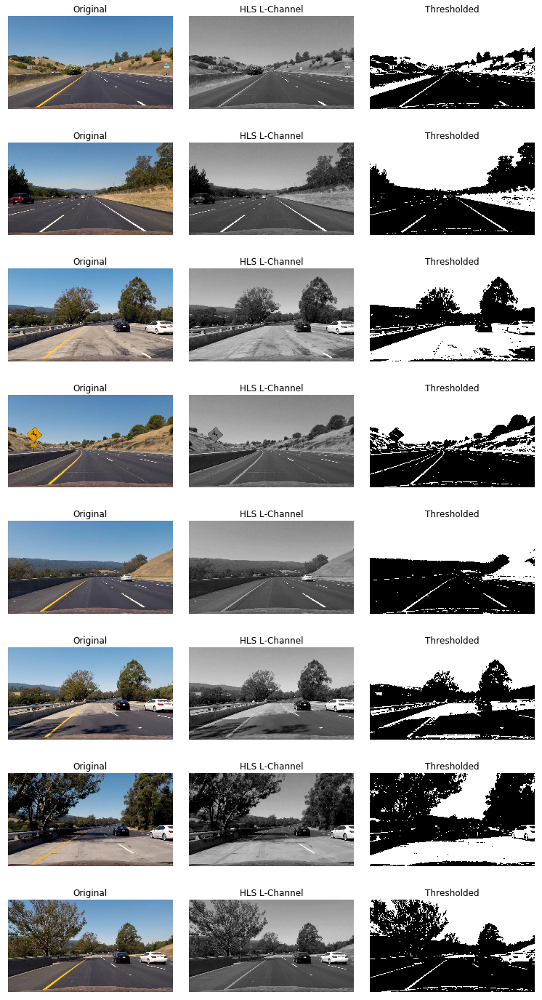

In [14]:
L_CHANNEL_THRESHOLD = (120, 255)

fig, gs = figure(figsize=(13, 25), gssize=(8, 3))
for i, image in enumerate(undist_images):
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)[:, :, 1]
    binary = np.zeros_like(gray)
    binary[(gray >= L_CHANNEL_THRESHOLD[0]) & (gray <= L_CHANNEL_THRESHOLD[1])] = 1
    
    imshow(image, gs[3*i], title='Original')
    imshow(gray, gs[3*i+1], title='HLS L-Channel', cmap='gray')
    imshow(binary, gs[3*i+2], title='Thresholded', cmap='gray')

### Put Them Altogether in HLS Color Space

In [15]:
def hls_threshold(image):
    """
    Generates thresholded binary image in HLS colorspace.
    """
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    image_H = hls[:, :, 0]
    image_L = hls[:, :, 1]
    image_S = hls[:, :, 2]
    
    binary = np.zeros_like(image_H)
    binary[
        (image_H >= H_CHANNEL_THRESHOLD[0]) & (image_H <= H_CHANNEL_THRESHOLD[1]) &
        (image_L >= L_CHANNEL_THRESHOLD[0]) & (image_L <= L_CHANNEL_THRESHOLD[1]) &
        (image_S >= S_CHANNEL_THRESHOLD[0]) & (image_S <= S_CHANNEL_THRESHOLD[1])
    ] = 1
    return binary

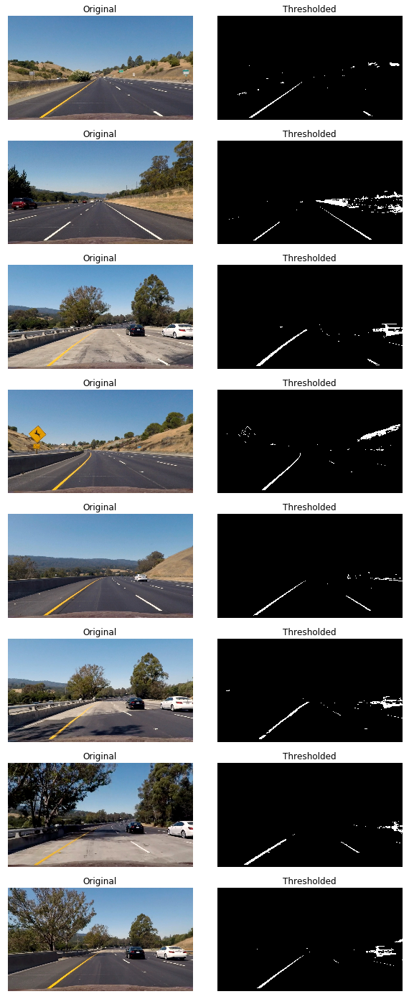

In [16]:
hls_binary_images = []
fig, gs = figure(figsize=(10, 25), gssize=(8, 2))
for i, image in enumerate(undist_images):
    binary = hls_threshold(image)
    imshow(image, gs[2*i], 'Original')
    imshow(binary, gs[2*i+1], 'Thresholded', cmap='gray')
    
    hls_binary_images.append(binary)

### Functions to Calculate Gradient

In [17]:
SOBEL_KERNEL_SIZE = 3
SOBEL_ABS_THRESHOLD = (25, 255)
SOBEL_MAG_THRESHOLD = (110, 255)
SOBEL_DIR_THRESHOLD = (0.7, 1.2)

In [18]:
def sobel(image):
    """
    Calcuates the gradient and sets threshold.
    """
    sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=SOBEL_KERNEL_SIZE)
    sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=SOBEL_KERNEL_SIZE)
    
    abs_sobel_x = np.absolute(sobel_x)
    abs_sobel_y = np.absolute(sobel_y)
    
    mag_sobel = np.sqrt(abs_sobel_x ** 2 + abs_sobel_y ** 2)
    dir_sobel = np.arctan2(abs_sobel_y, abs_sobel_x)
    
    scaled_abs_sobel_x = np.uint8(255 * abs_sobel_x / np.max(abs_sobel_x))
    scaled_mag_sobel = np.uint8(255 * mag_sobel / np.max(mag_sobel))
    
    binary = np.zeros_like(image)
    
    binary[
        (scaled_abs_sobel_x >= SOBEL_ABS_THRESHOLD[0]) & (scaled_abs_sobel_x <= SOBEL_ABS_THRESHOLD[1]) |
        (scaled_mag_sobel >= SOBEL_MAG_THRESHOLD[0]) & (scaled_mag_sobel <= SOBEL_MAG_THRESHOLD[1]) &
        (dir_sobel >= SOBEL_DIR_THRESHOLD[0]) & (dir_sobel <= SOBEL_DIR_THRESHOLD[1])
    ] = 1
    return binary

In [19]:
def sobel_threshold(image):
    """
    Generates thresholded gradient binary image.
    """
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    return sobel(gray)

### Plot Threholded Gradient

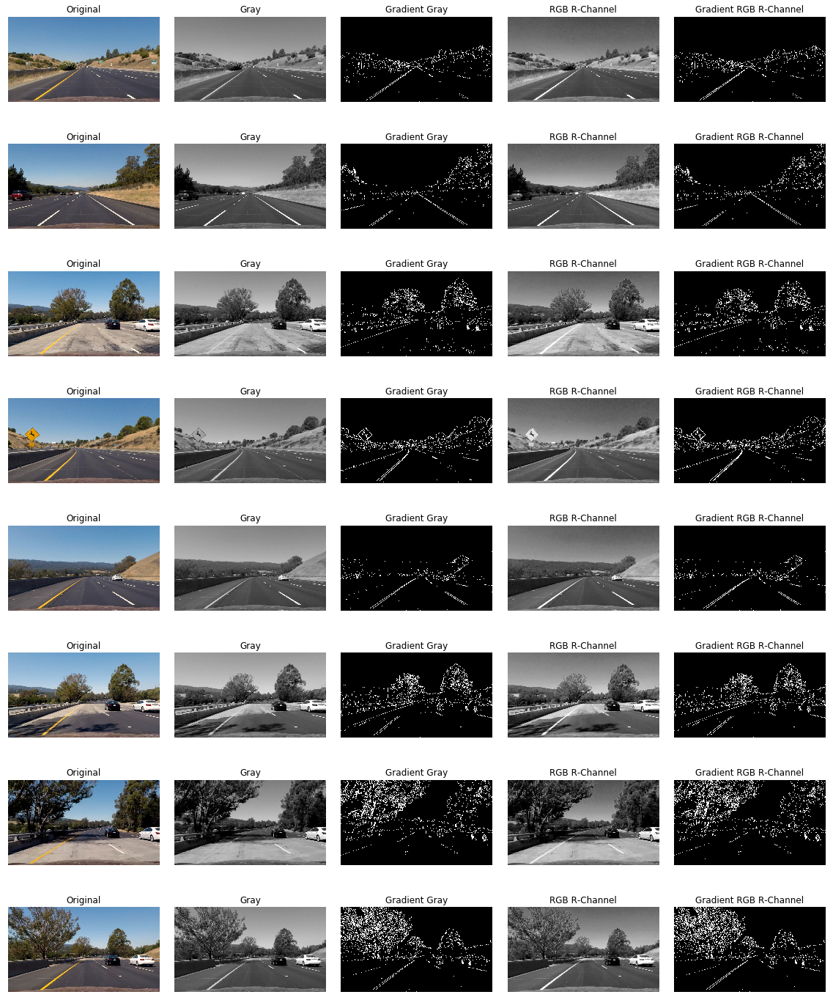

In [20]:
sobel_binary_images = []
fig, gs = figure(figsize=(20, 25), gssize=(8, 5))
for i, image in enumerate(undist_images):
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    image_R = image[:, :, 0]
    binary = sobel(gray)
    
    sobel_gray = sobel(gray)
    sobel_image_R = sobel(image_R)
    sobel_binary_images.append(sobel_gray)
    
    imshow(image, gs[5*i], title='Original')
    imshow(gray, gs[5*i+1], title='Gray', cmap='gray')
    imshow(binary, gs[5*i+2], title='Gradient Gray', cmap='gray')
    imshow(image_R, gs[5*i+3], title='RGB R-Channel', cmap='gray')
    imshow(sobel_image_R, gs[5*i+4], title='Gradient RGB R-Channel', cmap='gray')

### Plot Thresholded b-Channel in Lab Color Space

In [21]:
def b_threshold(image):
    """
    Generates thresholded b-channel binary image in Lab color space.
    """
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2Lab)[:, :, 2]
    binary = np.zeros_like(gray)
    binary[(gray >= B_CHANNEL_THRESHOLD[0]) & (gray <= B_CHANNEL_THRESHOLD[1])] = 1
    return binary

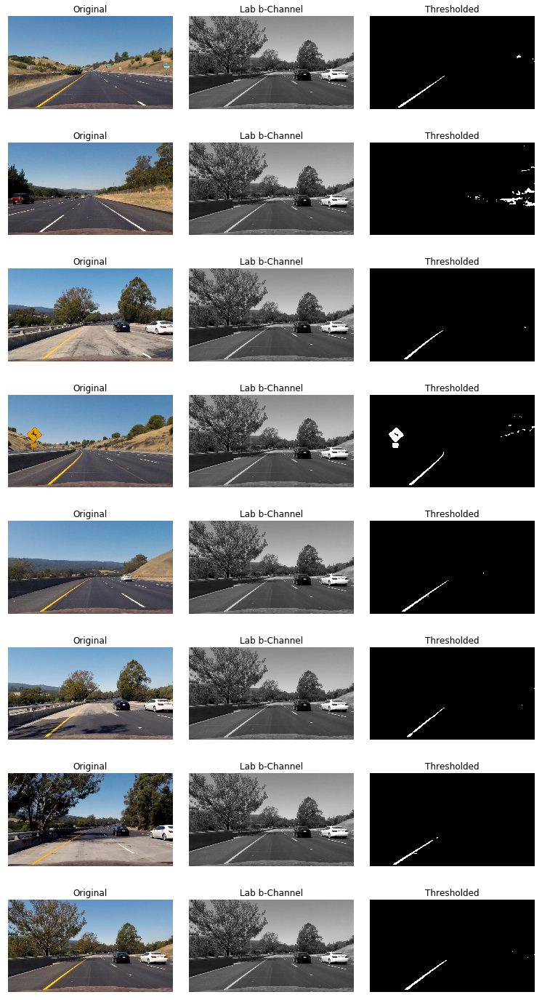

In [22]:
B_CHANNEL_THRESHOLD = (160, 255)

b_binary_images = []
fig, gs = figure(figsize=(13, 25), gssize=(8, 3))
for i, image in enumerate(undist_images):
    binary = b_threshold(image)
    b_binary_images.append(binary)
    
    imshow(image, gs[3*i], title='Original')
    imshow(gray, gs[3*i+1], title='Lab b-Channel', cmap='gray')
    imshow(binary, gs[3*i+2], title='Thresholded', cmap='gray')

In [23]:
def generate_threshold_binary(image):
    """
    Generates thresholded binary image.
    """
    hls_binary = hls_threshold(image)
    sobel_binary = sobel_threshold(image)
    b_binary = b_threshold(image)
    
    binary = np.zeros_like(hls_binary)
    binary[(hls_binary == 1) | (sobel_binary == 1) | (b_binary == 1)] = 1
    return binary

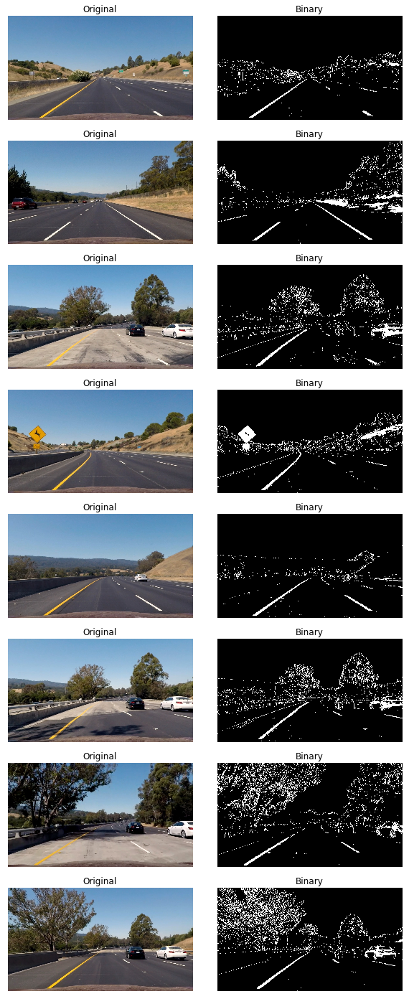

In [24]:
lane_binary_images = []
fig, gs = figure(figsize=(10, 25), gssize=(8, 2))
for i, image in enumerate(undist_images):
    binary = generate_threshold_binary(image)
    lane_binary_images.append(binary)
    
    imshow(image, gs[2*i], 'Original')
    imshow(binary, gs[2*i+1], 'Binary', cmap='gray')

## Perspective Transform

### Define Perspective Source and Destination Points

In [25]:
PERSPECTIVE_OFFSET = 320
PERSPECTIVE_SRC = np.float32([
    (585, 450),
    (695, 450),
    (1127, IMG_SIZE[0]),
    (203, IMG_SIZE[0])])
PERSPECTIVE_DST = np.float32([
    (PERSPECTIVE_OFFSET, 0),
    (IMG_SIZE[1] - PERSPECTIVE_OFFSET, 0),
    (IMG_SIZE[1] - PERSPECTIVE_OFFSET, IMG_SIZE[0]),
    (PERSPECTIVE_OFFSET, IMG_SIZE[0])
])

### Calculate Perspective Transform Matrix

In [26]:
M = cv2.getPerspectiveTransform(PERSPECTIVE_SRC, PERSPECTIVE_DST)
M_INV = cv2.getPerspectiveTransform(PERSPECTIVE_DST, PERSPECTIVE_SRC)

### Warp and Unwarp Functions

In [27]:
def warp(image):
    """
    Warps image.
    """
    return cv2.warpPerspective(image, M, IMG_SIZE[-2::-1], flags=cv2.INTER_LINEAR)

def unwarp(image):
    """
    Unwarps image.
    """
    return cv2.warpPerspective(image, M_INV, IMG_SIZE[-2::-1], flags=cv2.INTER_LINEAR)

### Plot ROI

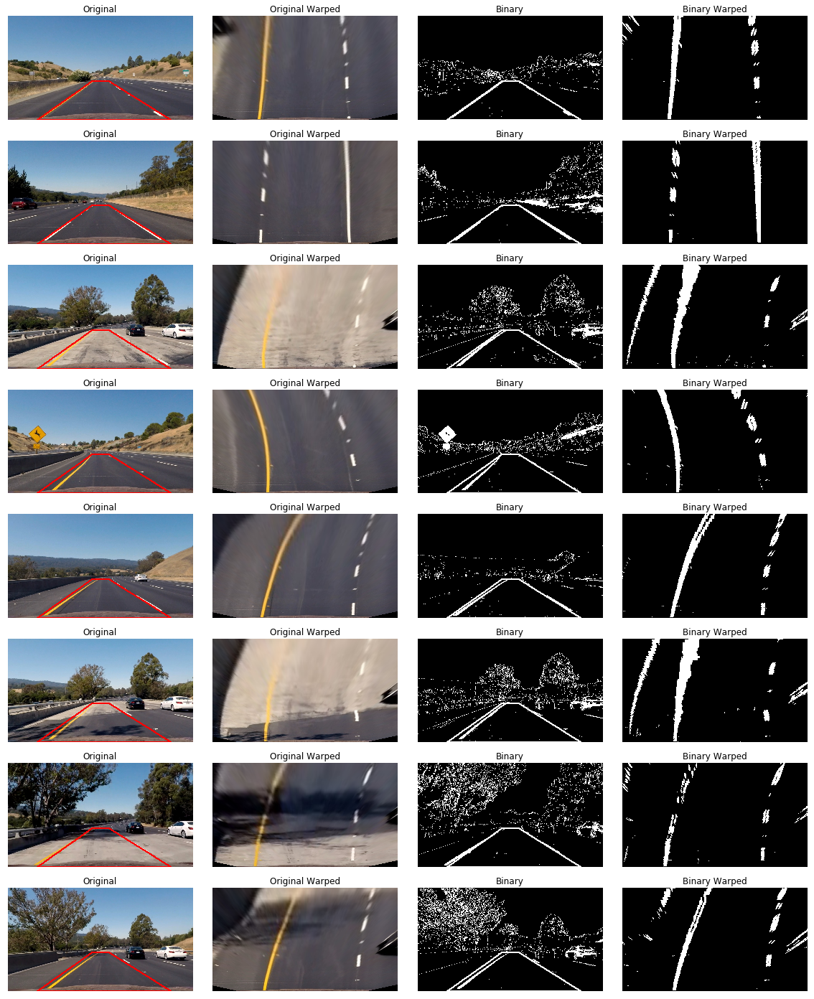

In [28]:
warped_lanes = []
fig, gs = figure(figsize=(20, 25), gssize=(8, 4))
for i, image in enumerate(undist_images):
    image_roi = np.copy(image)
    cv2.line(
        image_roi,
        (PERSPECTIVE_SRC[0][0], PERSPECTIVE_SRC[0][1]), (PERSPECTIVE_SRC[1][0], PERSPECTIVE_SRC[1][1]),
        (255, 0, 0), 10)
    cv2.line(
        image_roi,
        (PERSPECTIVE_SRC[1][0], PERSPECTIVE_SRC[1][1]), (PERSPECTIVE_SRC[2][0], PERSPECTIVE_SRC[2][1]),
        (255, 0, 0), 10)
    cv2.line(
        image_roi,
        (PERSPECTIVE_SRC[2][0], PERSPECTIVE_SRC[2][1]), (PERSPECTIVE_SRC[3][0], PERSPECTIVE_SRC[3][1]),
        (255, 0, 0), 10)
    cv2.line(
        image_roi,
        (PERSPECTIVE_SRC[3][0], PERSPECTIVE_SRC[3][1]), (PERSPECTIVE_SRC[0][0], PERSPECTIVE_SRC[0][1]),
        (255, 0, 0), 10)
    image_warped = warp(image)
    
    lane = lane_binary_images[i]
    lane_roi = np.copy(lane)
    cv2.line(
        lane_roi,
        (PERSPECTIVE_SRC[0][0], PERSPECTIVE_SRC[0][1]), (PERSPECTIVE_SRC[1][0], PERSPECTIVE_SRC[1][1]),
        1, 10)
    cv2.line(
        lane_roi,
        (PERSPECTIVE_SRC[1][0], PERSPECTIVE_SRC[1][1]), (PERSPECTIVE_SRC[2][0], PERSPECTIVE_SRC[2][1]),
        1, 10)
    cv2.line(
        lane_roi,
        (PERSPECTIVE_SRC[2][0], PERSPECTIVE_SRC[2][1]), (PERSPECTIVE_SRC[3][0], PERSPECTIVE_SRC[3][1]),
        1, 10)
    cv2.line(
        lane_roi,
        (PERSPECTIVE_SRC[3][0], PERSPECTIVE_SRC[3][1]), (PERSPECTIVE_SRC[0][0], PERSPECTIVE_SRC[0][1]),
        1, 10)
    lane_warped = warp(lane)
    warped_lanes.append(lane_warped)
    
    imshow(image_roi, gs[4*i], 'Original')
    imshow(image_warped, gs[4*i+1], 'Original Warped')
    imshow(lane_roi, gs[4*i+2], 'Binary', cmap='gray')
    imshow(lane_warped, gs[4*i+3], 'Binary Warped', cmap='gray')

### Finding and Fitting the Lines

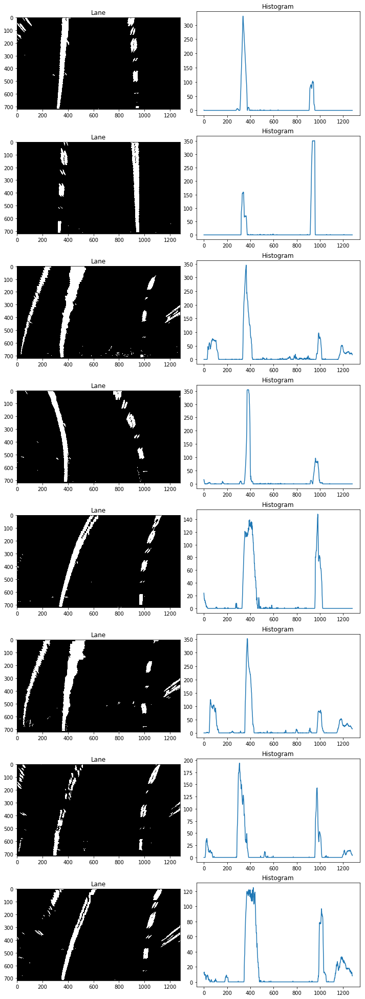

In [29]:
fig, gs = figure(figsize=(12, 35), gssize=(8, 2))
for i, image in enumerate(warped_lanes):
    histogram = np.sum(image[image.shape[0] // 2:], axis=0)
    
    plt.subplot(gs[2*i])
    plt.imshow(image, cmap='gray')
    plt.title('Lane')

    plt.subplot(gs[2*i+1])
    plt.plot(histogram)
    plt.title('Histogram')

In [30]:
NUM_WINDOWS = 10
MARGIN = 100
MIN_COUNT = 50

def sliding_window_search(image):
    """
    Finds and fits lines using sliding window search.
    """
    histogram = np.sum(image[image.shape[0] // 2:], axis=0)
    
    mid_point = histogram.shape[0] // 2
    left_base = np.argmax(histogram[:mid_point])
    right_base = np.argmax(histogram[mid_point:]) + mid_point
    
    window_height = image.shape[0] // NUM_WINDOWS
    
    nonzero = image.nonzero()
    nonzero_y = np.array(nonzero[0])
    nonzero_x = np.array(nonzero[1])
    
    left_current = left_base
    right_current = right_base
    
    sliding_windows = []
    left_lane_coords = []
    right_lane_coords = []
    
    for n in range(NUM_WINDOWS):
        left_x_low = left_current - MARGIN
        left_x_high = left_current + MARGIN
        right_x_low = right_current - MARGIN
        right_x_high = right_current + MARGIN
        y_low = image.shape[0] - (n + 1) * window_height
        y_high = image.shape[0] - n * window_height
        sliding_windows.append([
            (left_x_low, y_low), (left_x_high, y_high), # left rectangle
            (right_x_low, y_low), (right_x_high, y_high)]) # right rectangle
        
        in_left_window_coords = (
            (nonzero_x >= left_x_low) &
            (nonzero_x <= left_x_high) &
            (nonzero_y >= y_low) &
            (nonzero_y <= y_high)).nonzero()[0]
        left_lane_coords.append(in_left_window_coords)
        
        in_right_window_coords = (
            (nonzero_x >= right_x_low) &
            (nonzero_x <= right_x_high) &
            (nonzero_y >= y_low) &
            (nonzero_y <= y_high)).nonzero()[0]
        right_lane_coords.append(in_right_window_coords)
        
        if len(in_left_window_coords) >= MIN_COUNT:
            left_current = np.int(np.mean(nonzero_x[in_left_window_coords]))
        if len(in_right_window_coords) >= MIN_COUNT:
            right_current = np.int(np.mean(nonzero_x[in_right_window_coords]))
        
    left_lane_coords = np.concatenate(left_lane_coords)
    right_lane_coords = np.concatenate(right_lane_coords)
    
    x_left = nonzero_x[left_lane_coords]
    y_left = nonzero_y[left_lane_coords]
    x_right = nonzero_x[right_lane_coords]
    y_right = nonzero_y[right_lane_coords]
    
    left_fit, right_fit = None, None
    if len(x_left) != 0:
        left_fit = np.polyfit(y_left, x_left, 2)
    if len(x_right) != 0:
        right_fit = np.polyfit(y_right, x_right, 2)
        
    return left_fit, right_fit, left_lane_coords, right_lane_coords, sliding_windows

In [31]:
def plot_sliding_window_search(image, gs, left_fit, right_fit, left_lane_coords, right_lane_coords, sliding_windows, title=None):
    """
    Visualizes the sliding window search progress
    """
    plot_y = np.linspace(0, image.shape[0] - 1, image.shape[0])
    left_fit_x = left_fit[0] * plot_y ** 2 + left_fit[1] * plot_y + left_fit[2]
    right_fit_x = right_fit[0] * plot_y ** 2 + right_fit[1] * plot_y + right_fit[2]
    
    nonzero = image.nonzero()
    nonzero_x = np.array(nonzero[1])
    nonzero_y = np.array(nonzero[0])
    
    out_image = np.dstack((image, image, image)) * 255
    out_image[nonzero_y[left_lane_coords], nonzero_x[left_lane_coords]] = (255, 0, 0)
    out_image[nonzero_y[right_lane_coords], nonzero_x[right_lane_coords]] = (0, 0, 255)
    
    for i, win in enumerate(sliding_windows):
        cv2.rectangle(
            out_image,
            win[0], win[1],
            (0, 255, 0), 3)
        cv2.rectangle(
            out_image,
            win[2], win[3],
            (0, 255, 0), 3)
    
    plt.subplot(gs)
    plt.imshow(out_image, interpolation='bilinear')
    if title is not None: plt.title(title)
    plt.plot(left_fit_x, plot_y, color='yellow', linewidth=3)
    plt.plot(right_fit_x, plot_y, color='yellow', linewidth=3)
    plt.xlim(0, 1280)
    plt.ylim(720, 0)

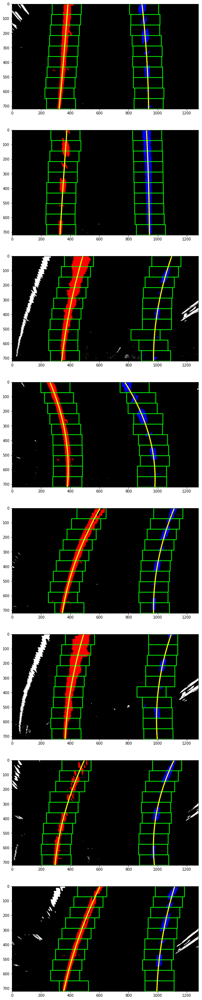

In [32]:
fig, gs = figure(figsize=(20, 50), gssize=(8, 1))
for i, image in enumerate(warped_lanes):
    left_fit, right_fit, left_lane_coords, right_lane_coords, sliding_windows = sliding_window_search(image)
    plot_sliding_window_search(image, gs[i], left_fit, right_fit, left_lane_coords, right_lane_coords, sliding_windows)

In [33]:
def prev_fit_search(image, prev_left_fit, prev_right_fit):
    """
    Finds and fits lines using previous fit search.
    """
    nonzero = image.nonzero()
    nonzero_x = np.array(nonzero[1])
    nonzero_y = np.array(nonzero[0])
    
    prev_left_fit_x = prev_left_fit[0] * nonzero_y ** 2 + prev_left_fit[1] * nonzero_y + prev_left_fit[2]
    prev_right_fit_x = prev_right_fit[0] * nonzero_y ** 2 + prev_right_fit[1] * nonzero_y + prev_right_fit[2]
    
    left_lane_coords = (nonzero_x >= prev_left_fit_x - MARGIN) & (nonzero_x <= prev_left_fit_x + MARGIN)
    right_lane_coords = (nonzero_x >= prev_right_fit_x - MARGIN) & (nonzero_x <= prev_right_fit_x + MARGIN)
    
    x_left = nonzero_x[left_lane_coords]
    y_left = nonzero_y[left_lane_coords]
    x_right = nonzero_x[right_lane_coords]
    y_right = nonzero_y[right_lane_coords]
    
    left_fit, right_fit = None, None
    if len(x_left) != 0:
        left_fit = np.polyfit(y_left, x_left, 2)
    if len(x_right) != 0:
        right_fit = np.polyfit(y_right, x_right, 2)
        
    return left_fit, right_fit, left_lane_coords, right_lane_coords

In [34]:
def plot_prev_fit_search(image, gs, prev_left_fit, prev_right_fit, left_fit, right_fit, left_lane_coords, right_lane_coords, title=None):
    """
    Visualizes the previours fit search progress.
    """
    plot_y = np.linspace(0, image.shape[0] - 1, image.shape[0])
    prev_left_fit_x = prev_left_fit[0] * plot_y ** 2 + prev_left_fit[1] * plot_y + prev_left_fit[2]
    prev_right_fit_x = prev_right_fit[0] * plot_y ** 2 + prev_right_fit[1] * plot_y + prev_right_fit[2]
    left_fit_x = left_fit[0] * plot_y ** 2 + left_fit[1] * plot_y + left_fit[2]
    right_fit_x = right_fit[0] * plot_y ** 2 + right_fit[1] * plot_y + right_fit[2]
    
    out_image = np.uint8(np.dstack((image, image, image)) * 255)
    out_overlay = np.zeros_like(out_image)
    
    nonzero = image.nonzero()
    nonzero_x = np.array(nonzero[1])
    nonzero_y = np.array(nonzero[0])
    
    out_image[nonzero_y[left_lane_coords], nonzero_x[left_lane_coords]] = [255, 0, 0]
    out_image[nonzero_y[right_lane_coords], nonzero_x[right_lane_coords]] = [0, 0, 255]
    
    left_line_window1 = np.array([np.transpose(np.vstack([prev_left_fit_x - MARGIN, plot_y]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([prev_left_fit_x + MARGIN, plot_y])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    
    right_line_window1 = np.array([np.transpose(np.vstack([prev_right_fit_x - MARGIN, plot_y]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([prev_right_fit_x + MARGIN, plot_y])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))
    
    cv2.fillPoly(out_overlay, np.int_([left_line_pts]), (0, 255, 0))
    cv2.fillPoly(out_overlay, np.int_([right_line_pts]), (0, 255, 0))
    out_image = cv2.addWeighted(out_overlay, 0.3, out_image, 0.7, 0)
    
    plt.subplot(gs)
    plt.imshow(out_image)
    plt.title(title)
    plt.plot(left_fit_x, plot_y, color='yellow', linewidth=3)
    plt.plot(right_fit_x, plot_y, color='yellow', linewidth=3)
    plt.xlim(0, 1280)
    plt.ylim(720, 0)

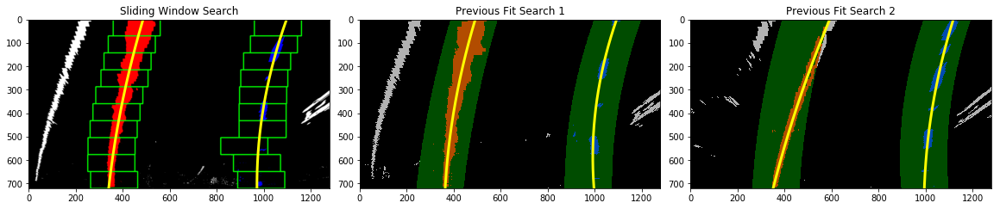

In [35]:
fig, gs = figure(figsize=(20, 15), gssize=(1, 3))

image = warped_lanes[2]
left_fit, right_fit, left_lane_coords, right_lane_coords, sliding_windows = sliding_window_search(image)
plot_sliding_window_search(image, gs[0], left_fit, right_fit, left_lane_coords, right_lane_coords, sliding_windows, 'Sliding Window Search')
prev_left_fit = left_fit
prev_right_fit = right_fit

image = warped_lanes[5]
left_fit, right_fit, left_lane_coords, right_lane_coords = prev_fit_search(image, prev_left_fit, prev_right_fit)
plot_prev_fit_search(image, gs[1], prev_left_fit, prev_right_fit, left_fit, right_fit, left_lane_coords, right_lane_coords, 'Previous Fit Search 1')
prev_left_fit = left_fit
prev_right_fit = right_fit

image = warped_lanes[7]
left_fit, right_fit, left_lane_coords, right_lane_coords = prev_fit_search(image, prev_left_fit, prev_right_fit)
plot_prev_fit_search(image, gs[2], prev_left_fit, prev_right_fit, left_fit, right_fit, left_lane_coords, right_lane_coords, 'Previous Fit Search 2')

### Calculating the Summary Data

In [36]:
YM_PER_PIX = 30 / 720
XM_PER_PIX = 3.7 / 700
    
def calc_curv_rad(image, left_fit, right_fit, left_lane_coords, right_lane_coords):
    """
    Calcuates the radius of curvature.
    """
    nonzero = image.nonzero()
    nonzero_x = np.array(nonzero[1])
    nonzero_y = np.array(nonzero[0])
    x_left = nonzero_x[left_lane_coords]
    y_left = nonzero_y[left_lane_coords]
    x_right = nonzero_x[right_lane_coords]
    y_right = nonzero_y[right_lane_coords]
    
    left_curve_rad, right_curve_rad = 0, 0
    if len(x_left) != 0 and len(x_right) != 0:
        left_fit_cr = np.polyfit(y_left * YM_PER_PIX, x_left * XM_PER_PIX, 2)
        right_fit_cr = np.polyfit(y_right * YM_PER_PIX, x_right * XM_PER_PIX, 2)
        
        plot_y = np.linspace(0, image.shape[0] - 1, image.shape[0])
        y_eval = np.max(plot_y)
        
        left_curve_rad = ((1 + (2 * left_fit_cr[0] * y_eval * YM_PER_PIX + left_fit_cr[1]) ** 2) ** 1.5) / np.absolute(2 * left_fit_cr[0])
        right_curve_rad = ((1 + (2 * right_fit_cr[0] * y_eval * YM_PER_PIX + right_fit_cr[1]) ** 2) ** 1.5) / np.absolute(2 * right_fit_cr[0])
        
    return left_curve_rad, right_curve_rad

In [37]:
def calc_center_dist(image, left_fit, right_fit):
    """
    Calculates the off center distance.
    """
    h, w = image.shape
    x_left = left_fit[0] * h ** 2 + left_fit[1] * h + left_fit[2]
    x_right = right_fit[0] * h ** 2 + right_fit[1] * h + right_fit[2]
    car_pos = w / 2
    lane_center_pos = (x_right + x_left) / 2
    center_dist = (car_pos - lane_center_pos) * XM_PER_PIX
    return center_dist

In [38]:
for i, image in enumerate(warped_lanes):
    left_fit, right_fit, left_lane_coords, right_lane_coords, sliding_windows = sliding_window_search(image)
    left_curve_rad, right_curve_rad = calc_curv_rad(image, left_fit, right_fit, left_lane_coords, right_lane_coords)
    center_dist = calc_center_dist(image, left_fit, right_fit)
    print('({}) left rad = {:.1f}m\t\tright rad = {:.1f}m\tcenter dist = {:.2f}cm'.format(
        i + 1, left_curve_rad, right_curve_rad, center_dist * 100))

(1) left rad = 10240.6m		right rad = 2292.9m	center dist = 4.76cm
(2) left rad = 14473.2m		right rad = 5513.8m	center dist = 1.60cm
(3) left rad = 1283.6m		right rad = 650.8m	center dist = -8.64cm
(4) left rad = 457.3m		right rad = 345.0m	center dist = -21.37cm
(5) left rad = 565.1m		right rad = 550.8m	center dist = -9.91cm
(6) left rad = 963.2m		right rad = 560.2m	center dist = -21.72cm
(7) left rad = 647.6m		right rad = 406.9m	center dist = 1.80cm
(8) left rad = 900.5m		right rad = 863.5m	center dist = -18.44cm


### Draw Hightlighted Overlay Back onto the Raw Image

In [39]:
def highlight_lanes(original_image, binary_image, left_fit, right_fit):
    """
    Creates a highlighted overlay and unwarp it back onto the raw image.
    """
    plot_y = np.linspace(0, binary_image.shape[0] - 1, binary_image.shape[0])
    x_left = left_fit[0] * plot_y ** 2 + left_fit[1] * plot_y + left_fit[2]
    x_right = right_fit[0] * plot_y ** 2 + right_fit[1] * plot_y + right_fit[2]
    
    pts_left = np.array([np.transpose(np.vstack([x_left, plot_y]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([x_right, plot_y])))])
    pts = np.hstack([pts_left, pts_right])
    
    binary_overlay = np.zeros_like(binary_image).astype(np.uint8)
    color_overlay = np.dstack([binary_overlay, binary_overlay, binary_overlay])
    
    cv2.fillPoly(color_overlay, np.int_(pts), (0, 255, 0))
    cv2.polylines(color_overlay, np.int32(pts_left), isClosed=False, color=(255, 0, 255), thickness=15)
    cv2.polylines(color_overlay, np.int32(pts_right), isClosed=False, color=(0, 255, 255), thickness=15)
    
    out_overlay = unwarp(color_overlay)
    out_image = np.copy(original_image)
    out_image = cv2.addWeighted(out_overlay, 0.3, out_image, 0.7, 0)
    
    return out_image

In [40]:
def show_summary(image, mean_curve_rad, center_dist):
    """
    Shows the summary data on video frames.
    """
    pil_image = Image.fromarray(image)
    draw = ImageDraw.Draw(pil_image)
    font = ImageFont.truetype('./OpenSans-Regular.ttf', 40)
    
    if mean_curve_rad > 5000:
        text = 'Straight'
    else:
        text = 'Radius of curvature: {:04.2f}m'.format(mean_curve_rad)
    draw.text((40, 30), text, font=font)
    
    offset = ''
    if center_dist < 0: offset = 'Left'
    if center_dist > 0: offset = 'Right'
    
    text = '{} of center: {:04.2f}cm'.format(offset, abs(center_dist) * 100)
    draw.text((40, 80), text, font=font)
    
    return np.array(pil_image)

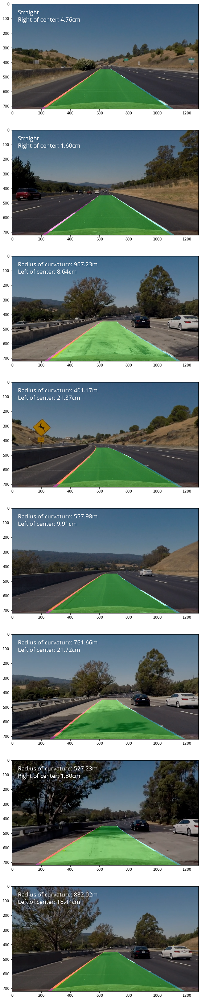

In [41]:
fig, gs = figure(figsize=(20, 50), gssize=(8, 1))
for i in range(8):
    original_image = undist_images[i]
    binary_image = warped_lanes[i]
    
    left_fit, right_fit, left_lane_coords, right_lane_coords, sliding_windows = sliding_window_search(binary_image)
    left_curve_rad, right_curve_rad = calc_curv_rad(binary_image, left_fit, right_fit, left_lane_coords, right_lane_coords)
    center_dist = calc_center_dist(binary_image, left_fit, right_fit)
    mean_curve_rad = (left_curve_rad + right_curve_rad) / 2
    
    result = highlight_lanes(original_image, binary_image, left_fit, right_fit)
    result = show_summary(result, mean_curve_rad, center_dist)
    
    imshow(result, gs[i], show_axis=True)

### Processing Video

In [42]:
class Line():
    def __init__(self):
        self.detected = False
        self.current_fit = []
        self.best_fit = None
        self.diffs = np.array([0, 0, 0], dtype='float')
        
    def add_fit(self, fit):
        if fit is None:
            self.detected = False
            if len(self.current_fit) > 0:
                self.current_fit = self.current_fit[:-1]
            if len(self.current_fit) > 0:
                self.best_fit = np.average(self.current_fit, axis=0)
        else:
            if self.best_fit is not None:
                self.diffs = abs(self.best_fit - fit)
            
            if self.diffs[0] > 0.001 or self.diffs[1] > 1.0 or self.diffs[2] > 100.0 and len(self.current_fit) > 0:
                self.detected = False
            else:
                self.detected = True
                self.current_fit.append(fit)
                if len(self.current_fit) > 5:
                    self.current_fit = self.current_fit[-5:]
                self.best_fit = np.average(self.current_fit, axis=0)

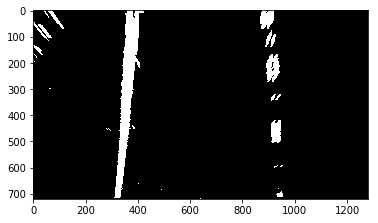

In [43]:
def pipeline(image):
    """
    Pipeline to preprocess image.
    """
    binary = generate_threshold_binary(image)
    binary = warp(binary)
    return binary


plt.imshow(pipeline(undist_images[0]), cmap='gray')

In [44]:
def transform_image(image, left_line, right_line):
    image = undistort(image)
    binary_image = pipeline(image)
    
    if not left_line.detected or not right_line.detected:
        left_fit, right_fit, left_lane_coords, right_lane_coords, _ = sliding_window_search(binary_image)
    else:
        left_fit, right_fit, left_lane_coords, right_lane_coords = prev_fit_search(
            binary_image, left_line.best_fit, right_line.best_fit)
        
    if left_fit is not None and right_fit is not None:
        h = binary_image.shape[0]
        left_intercept = left_fit[0] * h ** 2 + left_fit[1] * h + left_fit[2]
        right_intercept = right_fit[0] * h ** 2 + right_fit[1] * h + right_fit[2]
        delta = abs(right_intercept - left_intercept)
        if abs(600 - delta) > 100:
            left_fit, right_fit = None, None
            
    left_line.add_fit(left_fit)
    right_line.add_fit(right_fit)
    
    out_image = np.copy(image)
    if left_line.best_fit is not None and right_line.best_fit is not None:
        left_curve_rad, right_curve_rad = calc_curv_rad(
            binary_image, left_line.best_fit, right_line.best_fit, left_lane_coords, right_lane_coords)
        center_dist = calc_center_dist(binary_image, left_line.best_fit, right_line.best_fit)
        mean_curve_rad = (left_curve_rad + right_curve_rad) / 2
        
        out_image = highlight_lanes(out_image, binary_image, left_line.best_fit, right_line.best_fit)
        out_image = show_summary(out_image, mean_curve_rad, center_dist)
        
    return out_image

In [45]:
INPUT_VIDEO_FILE = './project_video.mp4'
OUTPUT_VIDEO_FILE = './project_video_output.mp4'

left_line, right_line = Line(), Line()

def process_video(clip, left_line, right_line):
    def process_video_frame(image):
        return transform_image(image, left_line, right_line)
    
    return clip.fl_image(process_video_frame)

input_video = VideoFileClip(INPUT_VIDEO_FILE)
output_video = input_video.fx(process_video, left_line, right_line)

In [46]:
%time output_video.write_videofile(OUTPUT_VIDEO_FILE, audio=False)

[MoviePy] >>>> Building video ./project_video_output.mp4
[MoviePy] Writing video ./project_video_output.mp4


100%|█████████▉| 1260/1261 [04:47<00:00,  4.68it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./project_video_output.mp4 

CPU times: user 5min 20s, sys: 1min 8s, total: 6min 28s
Wall time: 4min 48s


In [47]:
HTML("""
<video width="640" height="360" controls>
  <source src="{}" type="video/mp4">
</video>
""".format(OUTPUT_VIDEO_FILE))

In [48]:
INPUT_VIDEO_FILE = './challenge_video.mp4'
OUTPUT_VIDEO_FILE = './challenge_video_output.mp4'

input_video = VideoFileClip(INPUT_VIDEO_FILE)
output_video = input_video.fx(process_video, left_line, right_line)

%time output_video.write_videofile(OUTPUT_VIDEO_FILE, audio=False)

[MoviePy] >>>> Building video ./challenge_video_output.mp4
[MoviePy] Writing video ./challenge_video_output.mp4


100%|██████████| 485/485 [01:44<00:00,  4.69it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./challenge_video_output.mp4 

CPU times: user 1min 59s, sys: 25.1 s, total: 2min 24s
Wall time: 1min 45s


In [49]:
HTML("""
<video width="640" height="360" controls>
  <source src="{}" type="video/mp4">
</video>
""".format(OUTPUT_VIDEO_FILE))

In [50]:
INPUT_VIDEO_FILE = './harder_challenge_video.mp4'
OUTPUT_VIDEO_FILE = './harder_challenge_video_output.mp4'

input_video = VideoFileClip(INPUT_VIDEO_FILE)
output_video = input_video.fx(process_video, left_line, right_line)

%time output_video.write_videofile(OUTPUT_VIDEO_FILE, audio=False)

[MoviePy] >>>> Building video ./harder_challenge_video_output.mp4
[MoviePy] Writing video ./harder_challenge_video_output.mp4


100%|█████████▉| 1199/1200 [05:12<00:00,  3.97it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./harder_challenge_video_output.mp4 

CPU times: user 5min 38s, sys: 1min 10s, total: 6min 49s
Wall time: 5min 13s


In [51]:
HTML("""
<video width="640" height="360" controls>
  <source src="{}" type="video/mp4">
</video>
""".format(OUTPUT_VIDEO_FILE))